<a href="https://colab.research.google.com/github/ManojKesani/100-Days-Of-ML-Code/blob/master/KD_image_retrival_final_iguess.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [22]:
!unzip /content/drive/MyDrive/datasets/image_retrieval.zip -d/content/data

Archive:  /content/drive/MyDrive/datasets/image_retrieval.zip
   creating: /content/data/dataset/
  inflating: /content/data/dataset/3604.jpg  
  inflating: /content/data/dataset/3487.jpg  
  inflating: /content/data/dataset/2902.jpg  
  inflating: /content/data/dataset/1484.jpg  
  inflating: /content/data/dataset/1175.jpg  
  inflating: /content/data/dataset/246.jpg  
  inflating: /content/data/dataset/3618.jpg  
  inflating: /content/data/dataset/3763.jpg  
  inflating: /content/data/dataset/2436.jpg  
  inflating: /content/data/dataset/3248.jpg  
  inflating: /content/data/dataset/1662.jpg  
  inflating: /content/data/dataset/4282.jpg  
  inflating: /content/data/dataset/2351.jpg  
  inflating: /content/data/dataset/4385.jpg  
  inflating: /content/data/dataset/2380.jpg  
  inflating: /content/data/dataset/4651.jpg  
  inflating: /content/data/dataset/2830.jpg  
  inflating: /content/data/dataset/1846.jpg  
  inflating: /content/data/dataset/1807.jpg  
  inflating: /content/data/da

In [23]:
!nvidia-smi

Sat Feb 20 05:34:04 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.39       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   69C    P0    30W /  70W |    350MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [26]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.applications.efficientnet import decode_predictions,preprocess_input

import glob

In [27]:
teacher_EffnetB0 = tf.keras.applications.EfficientNetB0(weights='imagenet' ,include_top=True,classifier_activation=None)


In [28]:
import pandas as pd

col_names = ['image_path','teacher_logits','label']
df = pd.DataFrame(columns=col_names)
# i = 0
for idx,path in enumerate(glob.iglob(r'/content/data/dataset/*.jpg')) :

  img = image.load_img(path,target_size=(224,224))
  x =img_to_array(img)
  x = np.expand_dims(x, axis=0)
  x = preprocess_input(x)
  preds = teacher_EffnetB0.predict(x)

  df.loc[idx] = [path,preds[0],decode_predictions(preds, top=1)[0][0][1]]
# print(i)

40960/35363 [==================================] - 0s 0us/step


In [29]:
preds[0].shape

(1000,)

In [30]:
for idx,row in enumerate(df.iterrows()):

  if row[1]['label'] == 'snow_leopard':
    df.iloc[idx]['label'] = 'leopard'
    
    # print(df.iloc[idx]['label'])

In [31]:
import collections
a = df['label'].tolist()

counter=collections.Counter(a)
print(counter)

Counter({'lion': 1239, 'tiger': 1065, 'leopard': 721, 'cheetah': 610, 'timber_wolf': 295, 'red_fox': 288, 'jaguar': 231, 'white_wolf': 69, 'Arctic_fox': 58, 'kit_fox': 48, 'coyote': 40, 'red_wolf': 31, 'grey_fox': 30, 'dingo': 4, 'dhole': 3, 'malamute': 2, 'tiger_cat': 1, 'Eskimo_dog': 1, 'cougar': 1, 'Norwegian_elkhound': 1})


<BarContainer object of 7 artists>

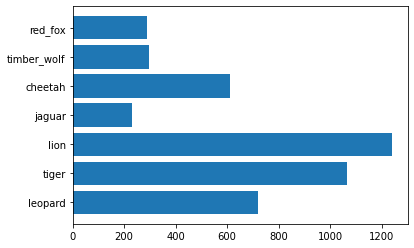

In [32]:
new_df = pd.DataFrame(columns=col_names)
i = 0
for idx,row in df.iterrows():
  label = row['label']
  
  if counter[label] >100:
    # print(type(row))
    new_df.loc[i] = row
    i += 1

import collections
a = new_df['label'].tolist()

counter=collections.Counter(a)

name = []
count = []

for key in counter.keys():
  name.append(key)
  count.append(counter[key])

import matplotlib.pyplot as plt

plt.barh(name,count)

In [33]:
counter

Counter({'cheetah': 610,
         'jaguar': 231,
         'leopard': 721,
         'lion': 1239,
         'red_fox': 288,
         'tiger': 1065,
         'timber_wolf': 295})

In [34]:
train_percentage = 0.85
val_percentage = 0.2
train_i = 0
val_i = 0
test_i = 0

train_df = pd.DataFrame(columns=col_names)
val_df = pd.DataFrame(columns=col_names)
test_df = pd.DataFrame(columns=col_names)

for label in counter.keys():
  foo_df = new_df[new_df['label']==label]
  label_count = counter[label]
  for idx,(_,row) in enumerate(foo_df.iterrows()):

    if idx <= int(label_count*train_percentage):
      train_df.loc[train_i] = row
      train_i += 1

    elif idx <= int(label_count*train_percentage + label_count*val_percentage) :
      val_df.loc[val_i] = row
      val_i += 1
      
    else:
      test_df.loc[val_i] = row
      test_i += 1

In [35]:
val_df

,image_path,teacher_logits,label
0,/content/data/dataset/2623.jpg,"[-0.24369149, -0.47926793, -0.4394789, 0.09888...",leopard
1,/content/data/dataset/547.jpg,"[-0.79049444, -0.1749743, -0.51248884, 0.20133...",leopard
2,/content/data/dataset/539.jpg,"[-0.9155914, -0.28677565, -0.25827056, 0.28274...",leopard
3,/content/data/dataset/4175.jpg,"[-0.3345756, -0.14036976, -0.47934458, 0.06702...",leopard
4,/content/data/dataset/2324.jpg,"[-0.3204622, -0.26797858, -0.21607783, 0.04116...",leopard
...,...,...,...
659,/content/data/dataset/3322.jpg,"[-0.66673046, 0.6542397, 0.6486122, -0.6081896...",red_fox
660,/content/data/dataset/2849.jpg,"[0.113020524, 0.38875818, 0.5143834, 0.6237796...",red_fox
661,/content/data/dataset/3034.jpg,"[-0.5292323, 1.4400101, 0.41992462, 0.12143633...",red_fox
662,/content/data/dataset/1979.jpg,"[0.093232855, 1.3386637, 0.73491454, 0.0238783...",red_fox


<BarContainer object of 7 artists>

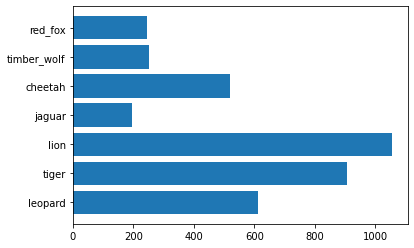

In [36]:
import collections
a = train_df['label'].tolist()

counter=collections.Counter(a)

name = []
count = []

for key in counter.keys():
  name.append(key)
  count.append(counter[key])

import matplotlib.pyplot as plt

plt.barh(name,count)

<BarContainer object of 7 artists>

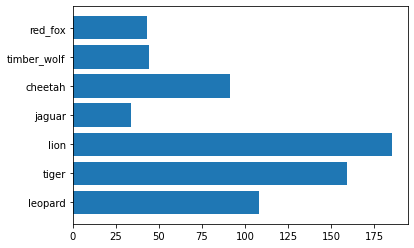

In [37]:
import collections
a = val_df['label'].tolist()

counter=collections.Counter(a)

name = []
count = []

for key in counter.keys():
  name.append(key)
  count.append(counter[key])

import matplotlib.pyplot as plt

plt.barh(name,count)

In [38]:
onehot_list = []
label_int = []


for l in train_df['label'].tolist():
  onehot = np.zeros(len(name))
  idx = name.index(l)
  onehot[idx] = 1
  onehot_list.append(onehot)


for l in train_df['label'].tolist():
  idx = name.index(l)
  label_int.append(idx)

train_df['label_onehot'] = onehot_list
train_df['label_int'] = label_int

onehot_list = []
label_int = []


for l in val_df['label'].tolist():
  onehot = np.zeros(len(name))
  idx = name.index(l)
  onehot[idx] = 1
  onehot_list.append(onehot)


for l in val_df['label'].tolist():
  idx = name.index(l)
  label_int.append(idx)

val_df['label_onehot'] = onehot_list
val_df['label_int'] = label_int


onehot_list = []
label_int = []


for l in test_df['label'].tolist():
  onehot = np.zeros(len(name))
  idx = name.index(l)
  onehot[idx] = 1
  onehot_list.append(onehot)


for l in test_df['label'].tolist():
  idx = name.index(l)
  label_int.append(idx)

test_df['label_onehot'] = onehot_list
test_df['label_int'] = label_int


In [39]:
train_df = train_df.sample(frac=1).reset_index(drop=True)

In [40]:
from tensorflow.keras.layers import Input, Dense, Conv2D, MaxPooling2D, UpSampling2D ,Flatten ,Reshape,Activation,BatchNormalization,concatenate
from tensorflow.keras.layers import Input, Activation, BatchNormalization, Dropout, Lambda, Conv2D, Conv2DTranspose, MaxPooling2D, concatenate,add,UpSampling2D

from keras.callbacks import TensorBoard
from keras.models import Model ,load_model
from keras.utils import Sequence
from keras.utils import plot_model
from keras import backend as K
from keras import preprocessing



from IPython.display import Image

from skimage.io import imread
from skimage import io
from skimage.transform import resize

from PIL import Image

import random

import albumentations as A
import cv2


In [41]:
class DataGenerator(Sequence):
  def __init__(self, path_list,teacher_logits,labels, batch_size, transform = None,flag = False,pix_transform = None):
    self.path_list = path_list
    self.batch_size = batch_size
    self.transform = transform
    self.logits = list(teacher_logits)
    self.labels = labels
    self.flag = flag
    self.pix_transform = pix_transform

  def __len__(self):
    return int(np.floor(len(self.path_list) / self.batch_size))

  def __getitem__(self,index):
    # print('working on batch ',index)
    paths = self.path_list[index*self.batch_size:(index+1)*self.batch_size]
    logit = self.logits[index*self.batch_size:(index+1)*self.batch_size]
    label = self.labels[index*self.batch_size:(index+1)*self.batch_size]

    x = np.empty((batch_size, 224, 224, 3), dtype=np.float32)
    super_x = np.empty((batch_size, 512, 512, 3), dtype=np.float32)
    t = np.empty((batch_size,1000))
    l = np.empty((batch_size,1))
    for idx, data in enumerate(zip(paths,logit,label)):
      # print(data)
      t[idx] =  data[1]
      l[idx] = data[2]
      


      if self.transform is not None:
        img = cv2.imread(data[0])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        transformed = transform(image=img)
        transformed_image = transformed["image"]
        super_x[idx] = transformed_image/255.

        transformed = pix_transform(image=transformed_image)
        transformed_image = transformed["image"]
        transformed_image = cv2.resize(transformed_image,(224,224))
        x[idx] = transformed_image/255.

      else:
        x[idx] = imread(data[0])/255.


    if self.flag == True:
      return (x , t , l , paths)
    
    return x , l ,super_x
 


In [42]:
train_path_list = train_df['image_path'].tolist()
train_teacher_logits = train_df['teacher_logits'].tolist()
train_OH_labels = train_df['label_onehot'].tolist()
train_labels = train_df['label_int'].tolist()



validation_path_list = val_df['image_path'].tolist()
validation_teacher_logits = val_df['teacher_logits'].tolist()
validation_OH_labels = val_df['label_onehot'].tolist()
validation_labels = val_df['label_int'].tolist()

test_path_list = test_df['image_path'].tolist()
test_teacher_logits = test_df['teacher_logits'].tolist()
test_OH_labels = test_df['label_onehot'].tolist()
test_labels = test_df['label_int'].tolist()


In [43]:
# !pip install -q -U albumentations
# !echo "$(pip freeze | grep albumentations) is successfully installed"

In [49]:

pix_transform = A.Compose([
    A.Cutout(num_holes=42, max_h_size=3, max_w_size=3,p=0.5)
])
transform = A.Compose([
    # A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.ShiftScaleRotate(),
    A.RandomSizedCrop([400,400],512,512),
    # A.Transpose(),
    # A.Blur(),
    # A.Cutout(num_holes=8, max_h_size=16, max_w_size=16,p=0.8)
])

batch_size = 32

# train_data = DataGenerator(x_train,y_train, batch_size,transform=transform)
# validation_data = DataGenerator(x_test,y_test, batch_size,transform=transform)

train_data = DataGenerator(train_path_list,train_teacher_logits,train_labels, batch_size,flag = False,transform=transform,pix_transform = pix_transform)
validation_data = DataGenerator(validation_path_list,validation_teacher_logits,validation_labels, batch_size,flag = False,transform=transform,pix_transform = pix_transform)

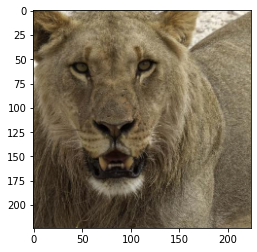

In [50]:
a,_,super_x = next(iter(train_data))
plt.imshow(a[1])


In [51]:
a[1].shape,super_x[1].shape

((224, 224, 3), (512, 512, 3))

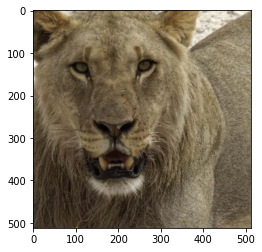

In [52]:
plt.imshow(super_x[1])

In [ ]:
test_preds = teacher_EffnetB0(a[1])

ValueError: ignored

#nonresmodel

In [11]:
OUTPUT_CHANNELS = 3
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

def dense(nodes,activation = 'relu'):
  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Dense(nodes,activation=activation)
  )

  return result

def convo1d(filters,activation = 'relu'):
  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv1D(filters,1,activation=activation)
  )

  return result


In [12]:
def unet_like():
  inputs = tf.keras.layers.Input(shape=[224,224,3])

  down_stack = [
    downsample(8, 4, apply_batchnorm=False), # (bs, 256, 256, 64)
    downsample(8, 4), # (bs, 64, 64, 128)?
    downsample(8, 4), # (bs, 32, 32, 256)?
    downsample(16, 4), # (bs, 16, 16, 512)?
    downsample(16, 4), # (bs, 8, 8, 512)?
    downsample(32, 4), # (bs, 4, 4, 512)?
    downsample(32, 4), # (bs, 2, 2, 512)?
    downsample(64, 4), # (bs, 1, 1, 512)?
  ]

  up_stack = [
    upsample(64, 4, apply_dropout=True), # (bs, 2, 2, 1024)?
    upsample(64, 4, apply_dropout=True), # (bs, 4, 4, 1024)?
    upsample(32, 4, apply_dropout=True), # (bs, 8, 8, 1024)?
    upsample(32, 4), # (bs, 16, 16, 1024)?
    upsample(16, 4), # (bs, 32, 32, 512)?
    upsample(16, 4), # (bs, 64, 64, 256)?
    upsample(8, 4), # (bs, 128, 128, 128)?
    upsample(8, 4), # (bs, 128, 128, 128)?
    # upsample(8, 4),
    # upsample(8, 4),
    # upsample(8, 4),
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='sigmoid') # (bs, 512, 512, 3)
  print('hi')

  x = inputs

  # Downsampling through the model
  skips = []
  for idx,down in enumerate(down_stack):
    x = down(x)
    skips.append(x)

    #attach student
    # if idx == len(down_stack)-2:
    #   s1 = x

  skips = reversed(skips[:-1])

  shape_before_flattening = K.int_shape(x)
  

  x = Flatten()(x)
  shape_after_flattening = K.int_shape(x)
  print(shape_after_flattening)

  encode = dense(512)(x)
  x = dense(shape_after_flattening[1])(encode)

  x = Reshape(shape_before_flattening[1:])(x)



  # Upsampling and establishing the skip connections
  # for idx,(up, skip) in enumerate(zip(up_stack, skips)):
  i = 0
  for up in (up_stack):
    
    #attach student
    if i == 3:
      s1 = x
      # break

    x = up(x)
    # if idx>=3:
    #   # x = tf.keras.layers.Concatenate()([x, skip])
    #   pass
    i += 1

    
    

  x = last(x)

  #student stuff

  # # s2 = tf.keras.layers.Flatten()(s1)
  # # sx1 = dense(1024)(s2)
  # # sx2 = dense(1000,activation=None)(sx1)

  # s2 = tf.keras.layers.Flatten()(s1)
  # sx2 = dense(1000,activation=None)(s2)  #38,706,027 good at 30 epochs

  s2 = downsample(32, 4)(s1)
  s3 = downsample(16, 4)(s2)
  s4 = tf.keras.layers.Flatten()(s3)
  sx2 = dense(1000,activation=None)(s4)     #6,267,947






  return tf.keras.Model(inputs=inputs, outputs=[x,sx2,encode])

In [ ]:
model = unet_like()
# tf.keras.utils.plot_model(model, show_shapes=True, dpi=64)
# model.summary()

hi
(None, 64)


#resmodel

In [13]:

import keras
def bn_act(x, act=True):
    x = keras.layers.BatchNormalization()(x)
    if act == True:
        x = keras.layers.Activation("relu")(x)
    return x

def conv_block(x, filters, kernel_size=(3, 3), padding="same", strides=1):
    conv = bn_act(x)
    conv = keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides)(conv)
    return conv

def stem(x, filters, kernel_size=(3, 3), padding="same", strides=1):
    conv = keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides)(x)
    conv = conv_block(conv, filters, kernel_size=kernel_size, padding=padding, strides=strides)
    
    shortcut = keras.layers.Conv2D(filters, kernel_size=(1, 1), padding=padding, strides=strides)(x)
    shortcut = bn_act(shortcut, act=False)
    
    output = keras.layers.Add()([conv, shortcut])
    return output

def residual_block(x, filters, kernel_size=(3, 3), padding="same", strides=1):
    res = conv_block(x, filters, kernel_size=kernel_size, padding=padding, strides=strides)
    res = conv_block(res, filters, kernel_size=kernel_size, padding=padding, strides=1)
    
    shortcut = keras.layers.Conv2D(filters, kernel_size=(1, 1), padding=padding, strides=strides)(x)
    shortcut = bn_act(shortcut, act=False)
    
    output = keras.layers.Add()([shortcut, res])
    return output

def upsample_concat_block(x, xskip):
    u = keras.layers.UpSampling2D((2, 2))(x)
    # c = keras.layers.Concatenate()([u, xskip])
    return u

def dense(nodes,activation = 'relu'):
  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Dense(nodes,activation=activation)
  )
  return result

In [99]:
def ResUNet():
    f = [8, 16, 32, 64, 128,256]
    inputs = keras.layers.Input((224, 224, 3))
    e0 = Conv2D(16, kernel_size = 7, padding='same', strides=2)(inputs)
    
    ## Encoder
    # e0 = inputs
    e1 = stem(e0, f[0])
    e2 = residual_block(e1, f[1], strides=2)
    e3 = residual_block(e2, f[2], strides=2)
    e4 = residual_block(e3, f[3], strides=2)
    e5 = residual_block(e4, f[4], strides=2)
    e6 = residual_block(e5, f[5], strides=2)
    
    ## Bridge
    b0 = conv_block(e6, f[4], strides=1)
    # shape_before_flattening = K.int_shape(b0)
    # x = Flatten()(b0)
    # shape_after_flattening = K.int_shape(x)
    # encode = dense(1024)(x)
    # x = dense(shape_after_flattening[1])(encode)
    # x = Reshape(shape_before_flattening[1:])(x)

    # TODO try conv to 1*1*256


    encode = Flatten()(b0)

    b1 = conv_block(b0, f[4], strides=1)
    
    ## Decoder
    u1 = upsample_concat_block(b1, e4)
    d1 = residual_block(u1, f[5])
    
    u2 = upsample_concat_block(d1, e3)
    d2 = residual_block(u2, f[5])

    s1 = d2
    s2 = downsample(16, 4)(s1)
    s3 = downsample(32, 4)(s2)
    s4 = tf.keras.layers.Flatten()(s3)
    sx2 = dense(1000,activation=None)(s4)


    
    u3 = upsample_concat_block(d2, e2)
    d3 = residual_block(u3, f[4])
    
    u4 = upsample_concat_block(d3, e1)
    d4 = residual_block(u4, f[4])

    u5 = upsample_concat_block(d4, e1)
    d5 = residual_block(u5, f[3])

    u6 = upsample_concat_block(d5, e1)
    d6 = residual_block(u6, f[2])

    u7 = upsample_concat_block(d6, e1)
    d7 = residual_block(u7, f[1])
    
    outputs = keras.layers.Conv2D(3, (1, 1), padding="same", activation="sigmoid")(d7)
    model = keras.models.Model(inputs, outputs=[outputs,sx2,encode])
    return model

In [100]:
model = ResUNet()
model.summary()
# tf.keras.utils.plot_model(model, show_shapes=True, dpi=64)


Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_362 (Conv2D)             (None, 112, 112, 16) 2368        input_12[0][0]                   
__________________________________________________________________________________________________
conv2d_363 (Conv2D)             (None, 112, 112, 8)  1160        conv2d_362[0][0]                 
__________________________________________________________________________________________________
batch_normalization_337 (BatchN (None, 112, 112, 8)  32          conv2d_363[0][0]                 
____________________________________________________________________________________________

In [101]:
model.output

[<KerasTensor: shape=(None, 512, 512, 3) dtype=float32 (created by layer 'conv2d_406')>,
 <KerasTensor: shape=(None, 1000) dtype=float32 (created by layer 'sequential_26')>,
 <KerasTensor: shape=(None, 2048) dtype=float32 (created by layer 'flatten_17')>]

In [102]:
import keras
class Distiller(keras.Model):
    def __init__(self, model,teacher):
        super(Distiller, self).__init__()
        self.model = model
        self.teacher = teacher

    def call(self,input_tensor,training=False):
      return self.model(input_tensor,training = training)


    def compile(
        self,
        optimizer,
        metrics,
        student_loss_fn,
        distillation_loss_fn,
        reconstruction_loss_fn,
        alpha=0.1,
        temperature=3,
    ):
        """ Configure the distiller.

        Args:
            optimizer: Keras optimizer for the student weights
            metrics: Keras metrics for evaluation
            student_loss_fn: Loss function of difference between student
                predictions and ground-truth
            distillation_loss_fn: Loss function of difference between soft
                student predictions and soft teacher predictions
            alpha: weight to student_loss_fn and 1-alpha to distillation_loss_fn
            temperature: Temperature for softening probability distributions.
                Larger temperature gives softer distributions.
        """
        super(Distiller, self).compile(optimizer=optimizer, metrics=metrics)
        self.student_loss_fn = student_loss_fn
        self.distillation_loss_fn = distillation_loss_fn
        self.reconstruction_loss_fn = reconstruction_loss_fn
        self.alpha = alpha
        self.temperature = temperature

    def train_step(self, data):
        # Unpack data
        x,y,super_x = data

        # Forward pass of teacher
        teacher_predictions = self.teacher(x)
        # print(teacher_predictions[0])

        with tf.GradientTape() as tape:
            # Forward pass of student
            reconstruction,student_predictions,_ = self.model(x, training=True)

            # Compute losses
            student_loss = self.student_loss_fn(y, student_predictions)
            distillation_loss = self.distillation_loss_fn(
                tf.nn.softmax(teacher_predictions / self.temperature, axis=1),
                tf.nn.softmax(student_predictions / self.temperature, axis=1),
            )
            s_loss = (self.alpha * student_loss + (1 - self.alpha) * distillation_loss)

            # reconstruction_loss = tf.reduce_mean(tf.reduce_sum(self.reconstruction_loss_fn(x, reconstruction), axis=(1, 2)))/(512*512) #keras.losses.binary_crossentropy
            reconstruction_loss = self.reconstruction_loss_fn(super_x, reconstruction) #keras.losses.binary_crossentropy


            loss = (s_loss*0.05 + reconstruction_loss)

        # Compute gradients
        trainable_vars = self.model.trainable_variables
        gradients = tape.gradient(loss, trainable_vars)

        # Update weights
        self.optimizer.apply_gradients(zip(gradients, trainable_vars))

        # Update the metrics configured in `compile()`.
        self.compiled_metrics.update_state(y, student_predictions)
        # self.compiled_metrics.update_state(x, reconstruction)

        # Return a dict of performance
        results = {m.name: m.result() for m in self.metrics}
        # results.update(
        #     {"student_loss": student_loss, "distillation_loss": distillation_loss,'s_loss':s_loss, 'rec_loss': reconstruction_loss, 'total_loss': loss}
        # )
        results.update(
            {'s_loss':s_loss, 'rec_loss': reconstruction_loss, 'total_loss': loss}
        )
        return results

    def test_step(self, data):
        # Unpack the data
        x, y,super_x = data

        # Compute predictions
        reconstruction,y_prediction,_ = self.model(x, training=False)
        

        # Calculate the loss
        student_loss = self.student_loss_fn(y, y_prediction)
        # reconstruction_loss = tf.reduce_mean(tf.reduce_sum(self.reconstruction_loss_fn(x, reconstruction), axis=(1, 2)))  #keras.losses.binary_crossentropy
        reconstruction_loss = self.reconstruction_loss_fn(super_x, reconstruction)
        loss = (student_loss*0.05 + reconstruction_loss)


        # Update the metrics.
        self.compiled_metrics.update_state(y, y_prediction)

        # Return a dict of performance
        results = {m.name: m.result() for m in self.metrics}
        results.update({"s_loss": student_loss, 'rec_loss': reconstruction_loss,'total_loss': loss})
        return results


In [103]:
!rm -r /content/output

In [104]:
train_data = DataGenerator(train_path_list,train_teacher_logits,train_labels, batch_size,flag = False,transform=transform,pix_transform = pix_transform)
validation_data = DataGenerator(validation_path_list,validation_teacher_logits,validation_labels, batch_size,flag = False,transform=transform,pix_transform = pix_transform)

In [105]:

# Initialize and compile distiller
distiller = Distiller(model = model, teacher = teacher_EffnetB0)
lr = 5e-4
opt = keras.optimizers.Adam(lr=lr)

# rll = tf.reduce_sum(
#                       tf.square(true - predicted),
#                       reduction_indices=[1, 2, 3]
#                       )
# reconstruction_loss = tf.reduce_mean(reconstruction_loss)


distiller.compile(
    optimizer=opt,
    metrics=[keras.metrics.SparseCategoricalAccuracy()],
    student_loss_fn=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=keras.losses.KLDivergence(),
    reconstruction_loss_fn = tf.keras.losses.MeanSquaredError(),
    
    alpha=0.5,
    temperature=10,
)
from keras.callbacks import LearningRateScheduler ,ReduceLROnPlateau

# reduce_lr = LearningRateScheduler(lr_scheduler)
reduce_lr = ReduceLROnPlateau(monitor='val_total_loss', factor=0.2,
                              patience=5, min_lr=1e-6, verbose=1)
# Distill teacher to student
distiller.fit(train_data,epochs=50,validation_data=validation_data,callbacks=[reduce_lr,TensorBoard(log_dir='/content/output')])
# distiller.fit(train_data,epochs=2)
# distiller.fit(train_data,epochs=300,callbacks=[reduce_lr,TensorBoard(log_dir='/content/output')])
# 
# Evaluate student on test dataset
# distiller.evaluate(x_test, y_test)


Epoch 1/50
118/118 [==============================] - 158s 1s/step - sparse_categorical_accuracy: 0.4307 - s_loss: 0.7075 - rec_loss: 0.0352 - total_loss: 0.0706 - val_sparse_categorical_accuracy: 0.2906 - val_s_loss: 3.3727 - val_rec_loss: 0.0506 - val_total_loss: 0.2193
Epoch 2/50
118/118 [==============================] - 147s 1s/step - sparse_categorical_accuracy: 0.7321 - s_loss: 0.3238 - rec_loss: 0.0285 - total_loss: 0.0447 - val_sparse_categorical_accuracy: 0.4906 - val_s_loss: 0.6517 - val_rec_loss: 0.0253 - val_total_loss: 0.0579
Epoch 3/50
118/118 [==============================] - 147s 1s/step - sparse_categorical_accuracy: 0.8298 - s_loss: 0.2316 - rec_loss: 0.0267 - total_loss: 0.0383 - val_sparse_categorical_accuracy: 0.7844 - val_s_loss: 0.5290 - val_rec_loss: 0.0399 - val_total_loss: 0.0663
Epoch 4/50
118/118 [==============================] - 147s 1s/step - sparse_categorical_accuracy: 0.8697 - s_loss: 0.1695 - rec_loss: 0.0257 - total_loss: 0.0342 - val_sparse_catego

KeyboardInterrupt: ignored

In [106]:
# 
%reload_ext tensorboard
%tensorboard --logdir /content/output

<IPython.core.display.Javascript object>

In [107]:
a,_,super_a = next(iter(validation_data))
out = distiller.predict(a)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


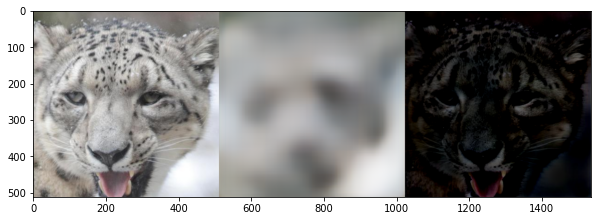

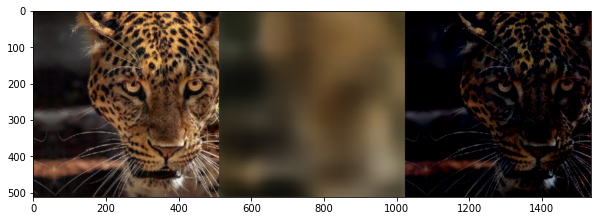

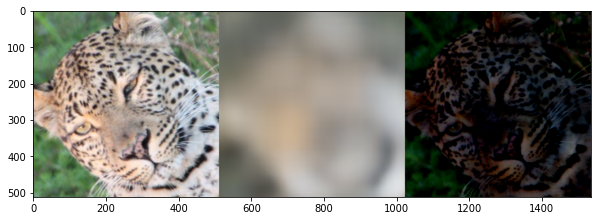

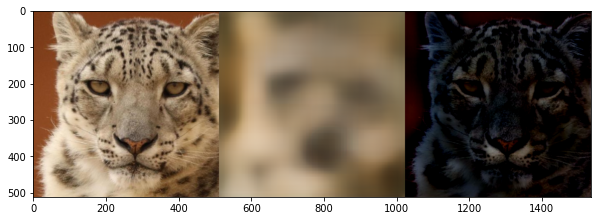

In [108]:
for i in range(out[0].shape[0]):
  if i>3:
    break
  plt.figure(figsize=(10,10))
  image = np.hstack((super_a[i],out[0][i],super_a[i]-out[0][i]))
  plt.imshow(image)


In [109]:
distiller.evaluate(validation_data)


20/20 [==============================] - 10s 467ms/step - sparse_categorical_accuracy: 0.9766 - s_loss: 0.0563 - rec_loss: 0.0200 - total_loss: 0.0228


[0.9765625, 0.013877453282475471, 0.025671131908893585, 0.015161009505391121]

In [110]:
# train_data = DataGenerator(train_path_list,train_teacher_logits,train_labels, batch_size,flag = True)
# validation_data = DataGenerator(validation_path_list,validation_teacher_logits,validation_labels, batch_size,flag = True)

train_data = DataGenerator(train_path_list,train_teacher_logits,train_labels, batch_size,flag = True,transform=transform,pix_transform = pix_transform)
validation_data = DataGenerator(validation_path_list,validation_teacher_logits,validation_labels, batch_size,flag = True,transform=transform,pix_transform = pix_transform)

In [111]:
output_df = pd.DataFrame(columns=['image_path','encoding','label','train/test'])

for data in train_data:

  images,_,labels,paths = data
  _,_,encodings = distiller.predict(images)

  for idx,encode in enumerate(encodings):
    output_df = output_df.append({'image_path':paths[idx],
                                  'encoding':encode,
                                  'label':labels[idx],
                                  'train/test':'train'},ignore_index=True)

  # print(encode.shape)
# validation_data
for data in validation_data:

  images,_,labels,paths = data
  _,_,encodings = distiller.predict(images)

  for idx,encode in enumerate(encodings):
    # print(encode.shape)
    output_df = output_df.append({'image_path':paths[idx],
                                  'encoding':encode,
                                  'label':labels[idx],
                                  'train/test':'val'},ignore_index=True)


In [112]:
train_encoded_data = output_df[output_df['train/test']=='train']['encoding']
train_lb = output_df[output_df['train/test']=='train']['label']
t_path = output_df[output_df['train/test']=='train']['image_path'].tolist()


val_encoded_data = output_df[output_df['train/test']=='val']['encoding']
val_lb = output_df[output_df['train/test']=='val']['label']
v_path = output_df[output_df['train/test']=='val']['image_path'].tolist()


In [113]:
print(train_encoded_data.shape,val_encoded_data.shape)

(3776,) (640,)


In [114]:
data_t = np.zeros((3776,2048))
l_t = np.zeros((3776,1))
pathlist_t = []

data_v = np.zeros((640,2048))
l_v = np.zeros((640,1))
pathlist_v = []

In [115]:
for idx, row in enumerate(train_encoded_data.iteritems()):
  data_t[idx] = np.array(row[1])

for idx, row in enumerate(train_lb.iteritems()):
  l_t[idx] = np.array(row[1])

for idx, row in enumerate(val_encoded_data.iteritems()):
  data_v[idx] = np.array(row[1])

for idx, row in enumerate(val_lb.iteritems()):
  l_v[idx] = np.array(row[1])

In [116]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=3, init='random', random_state=0)
proj_t = tsne.fit_transform(data_t)

tsne = TSNE(n_components=3, init='random', random_state=0)
proj_v = tsne.fit_transform(data_v)



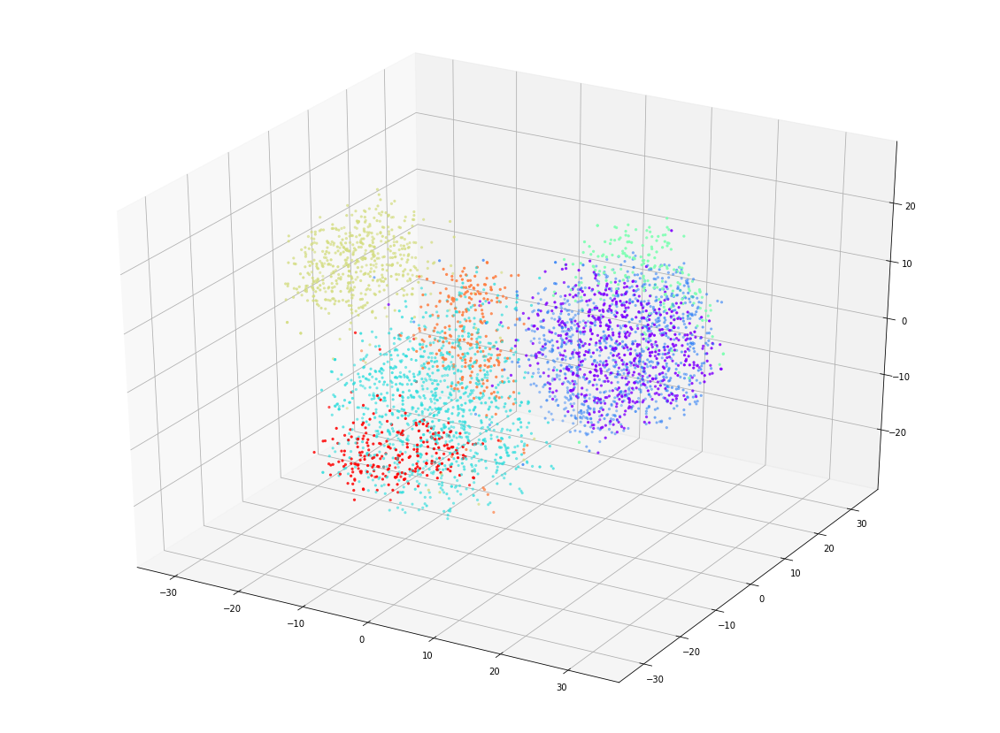

In [117]:
from mpl_toolkits import mplot3d

%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(20,15))
ax = plt.axes(projection='3d')
ax.scatter3D(proj_t[:, 0], proj_t[:, 1],proj_t[:, 2], c=l_t, s=5, cmap='rainbow')

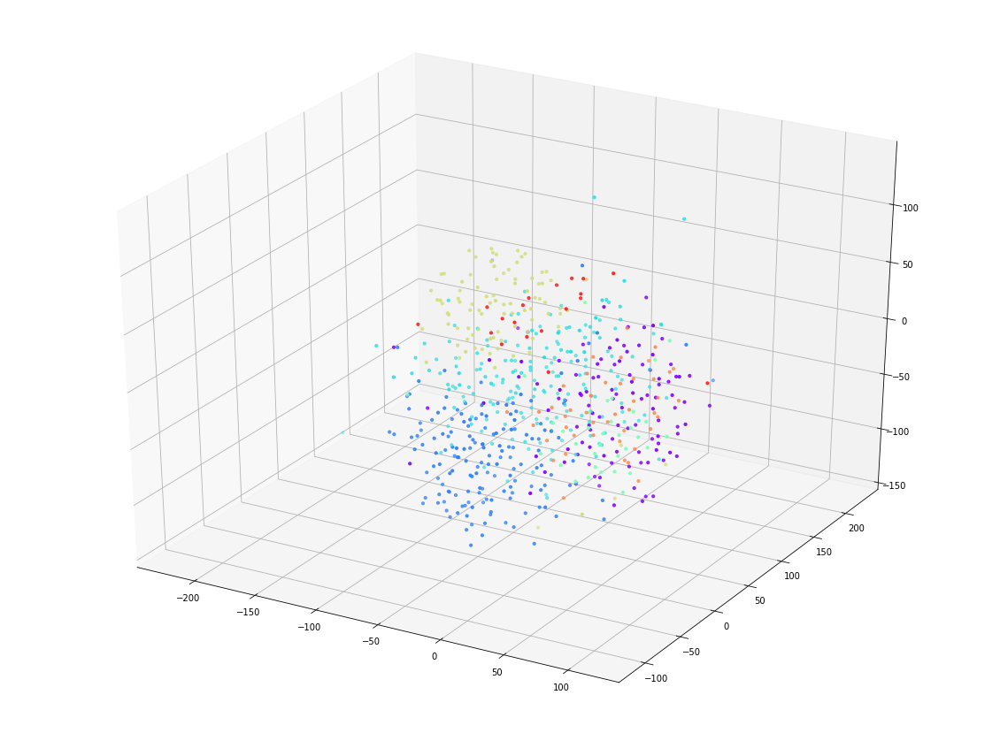

In [118]:
fig = plt.figure(figsize=(20,15))
ax = plt.axes(projection='3d')
ax.scatter3D(proj_v[:, 0], proj_v[:, 1],proj_v[:, 2], c=l_v, s=10, cmap='rainbow')

In [119]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, init='random', random_state=0)
proj_t = tsne.fit_transform(data_t)

tsne = TSNE(n_components=2, init='random', random_state=0)
proj_v = tsne.fit_transform(data_v)


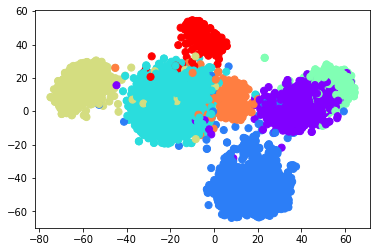

In [120]:
plt.scatter(proj_t[:, 0], proj_t[:, 1], c=l_t, s=50, cmap='rainbow');

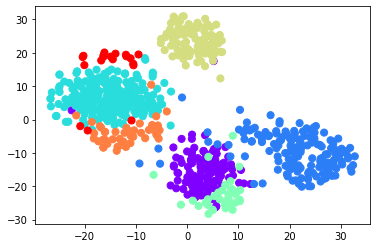

In [121]:
plt.scatter(proj_v[:, 0], proj_v[:, 1], c=l_v, s=50, cmap='rainbow');

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19


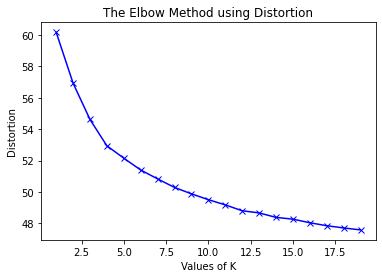

In [122]:


from scipy.spatial.distance import cdist 
from sklearn.cluster import KMeans 


distortions = [] 
inertias = [] 
mapping1 = {} 
mapping2 = {} 
Kk = range(1,20) 
  
for k in Kk:
  print(k)
  #Building and fitting the model 
  kmeanModel = KMeans(n_clusters=k)
  kmeanModel.fit(data_t)     
      
  distortions.append(sum(np.min(cdist(data_t, kmeanModel.cluster_centers_, 'euclidean'),axis=1)) / data_t.shape[0]) 
  inertias.append(kmeanModel.inertia_) 
  
  mapping1[k] = sum(np.min(cdist(data_t, kmeanModel.cluster_centers_, 'euclidean'),axis=1)) / data_t.shape[0] 
  mapping2[k] = kmeanModel.inertia_ 

# for key,val in mapping1.items(): 
#     print(str(key)+' : '+str(val)) 

plt.plot(Kk, distortions, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Distortion') 
plt.title('The Elbow Method using Distortion') 
plt.show()



In [123]:


kmeanModel_AE = KMeans(n_clusters=7)
kmeanModel_AE.fit(data_t)

# cluster numbers for training data
x_kmeans_AE = kmeanModel_AE.predict(data_t)

# cluster numbers for val data
y_kmeans_AE = kmeanModel_AE.predict(data_v)



In [124]:
# dataset_paths = output_df['image_path'].tolist()
# t_path = dataset_paths[:4000]
# v_path = dataset_paths[4000:]

db_cluster_path_list = {0:[],1:[],2:[],3:[],4:[],5:[],6:[],7:[]}
db_cluster_labels = {0:[],1:[],2:[],3:[],4:[],5:[],6:[],7:[]}
db_cluster_encoded = {0:[],1:[],2:[],3:[],4:[],5:[],6:[],7:[]}

q_cluster_path_list = {0:[],1:[],2:[],3:[],4:[],5:[],6:[],7:[]}
q_cluster_labels = {0:[],1:[],2:[],3:[],4:[],5:[],6:[],7:[]}
q_cluster_encoded = {0:[],1:[],2:[],3:[],4:[],5:[],6:[],7:[]}


for idx , cluster_number in enumerate(x_kmeans_AE):
  db_cluster_path_list[cluster_number].append(t_path[idx])
  db_cluster_labels[cluster_number].append(name[int(l_t[idx])])
  db_cluster_encoded[cluster_number].append(data_t[idx])


for idx , cluster_number in enumerate(y_kmeans_AE):
  q_cluster_path_list[cluster_number].append(v_path[idx])
  q_cluster_labels[cluster_number].append(name[int(l_v[idx])])
  q_cluster_encoded[cluster_number].append(data_v[idx])


In [125]:
q_cluster_labels

{0: ['tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger'],
 1: ['timber_wolf',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox',
  'red_fox'],
 2: ['leopard',
  'leopard',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'tiger',
  'lion',
  'lion',
  'lion',
  'lion',
  'lion',
  'lion',
  'lion',
  'lion'

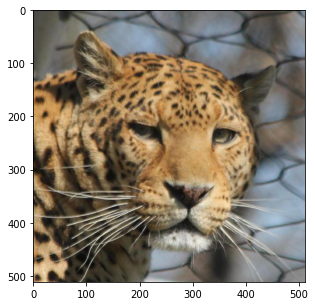

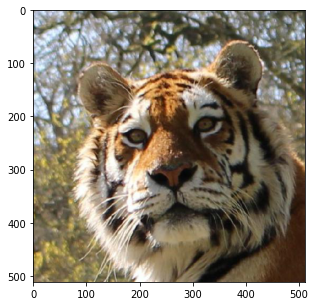

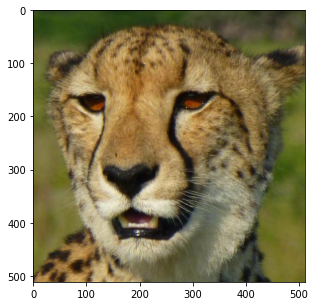

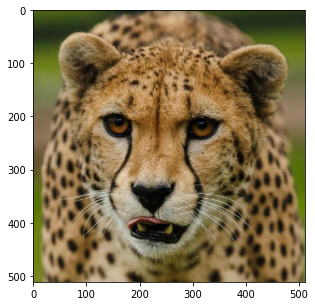

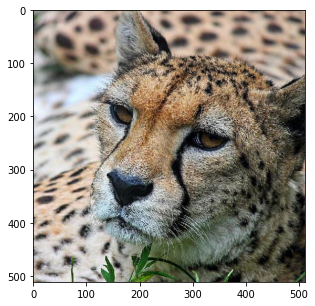

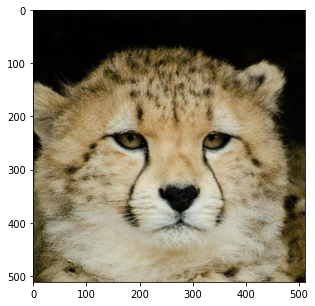

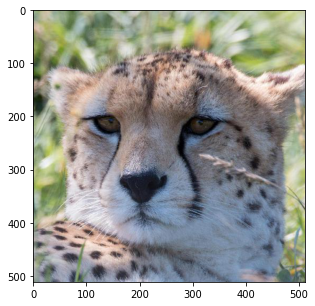

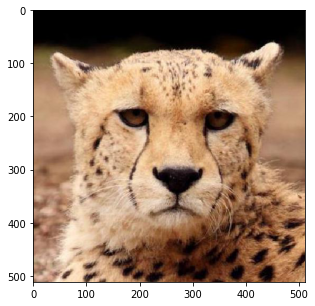

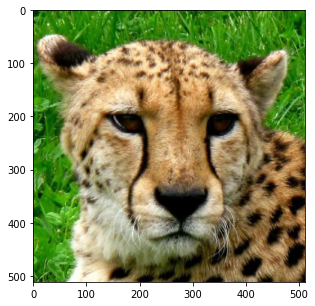

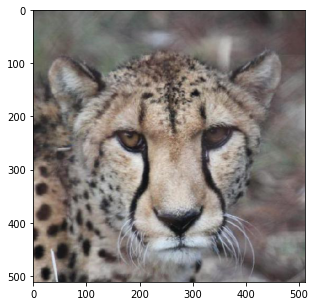

In [137]:


num = 6
i = 0
for path in q_cluster_path_list[num]:
  i+=1
  if i>10:
    break

  img = imread(path)
  
  plt.figure(figsize=(5,5))
  plt.imshow(img)



In [138]:
for i in range(7):
  print('images in cluster {}'.format(i), len(db_cluster_path_list[i]))

images in cluster 0 315
images in cluster 1 242
images in cluster 2 1385
images in cluster 3 253
images in cluster 4 276
images in cluster 5 835
images in cluster 6 470


In [139]:
cluster_num = 4
img_num = 5

results = []
q_encode = q_cluster_encoded[cluster_num][img_num]
q_path = q_cluster_path_list[cluster_num][img_num]

for db_encode,path in zip(db_cluster_encoded[cluster_num],db_cluster_path_list[cluster_num]):

  d = np.linalg.norm(q_encode - db_encode)
  results.append((d,path))

sorted_res = sorted(results)[:25]

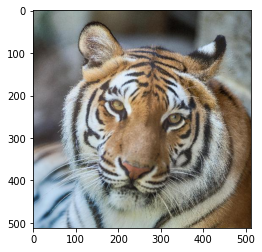

In [140]:


q_img = imread(q_path)
plt.imshow(q_img)



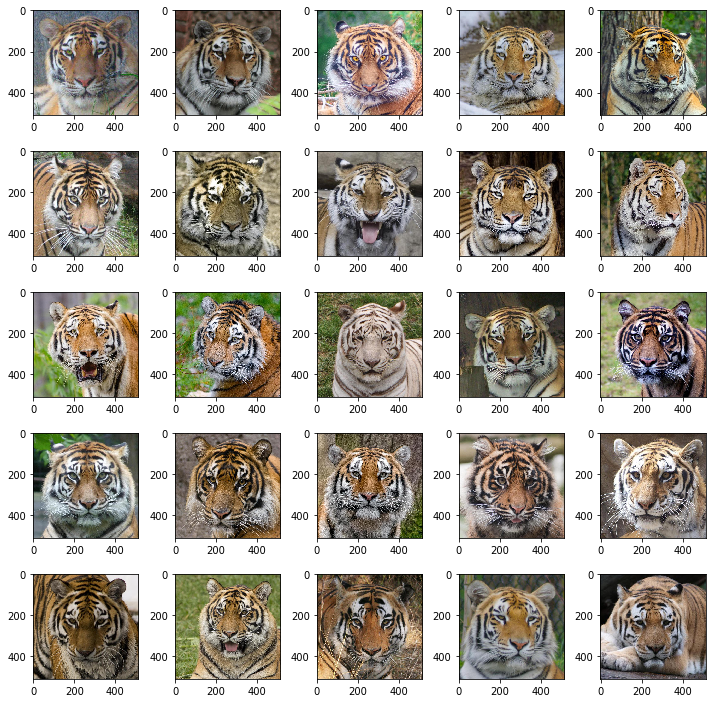

In [130]:
plt.figure(figsize=(10,10))
for idx , (_,path) in enumerate(sorted_res):
  image = imread(path)
  plt.subplot(5,5,idx+1)
  io.imshow(image)

plt.show()